# Case Study on Oise Data Set

In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
return false;
}

<IPython.core.display.Javascript object>

This case study reads information from the gstlearn repository.

In [2]:
ranges = [1000,5000]
oldMethod = False

In [3]:
import os
import matplotlib.pyplot as plt
import gstlearn as gl
import gstlearn.plot as gp
import numpy as np
import scipy as sp
from scipy import interpolate

In [4]:
filename = os.path.join(os.getenv('GSTLEARN_DATA'), "Oise", "Oise_Thickness.csv")

In [5]:
csv = gl.CSVformat(True, 0, ";", ",", "9999")
data = gl.Db.createFromCSV(filename, csv, True)
data.setLocator("X",gl.ELoc.X,0)
data.setLocator("Y",gl.ELoc.X,1)
data.setLocator("Epaisseur",gl.ELoc.L,0)
data.setLocator("Epaisseur_1",gl.ELoc.U,0)
data
sf = gl.DbStringFormat()
sf.setFlags(flag_stats=True)
data.display(sf)

Column Name (1): X
 Column Name (2): Y
 Column Name (3): Epaisseur
 Column Name (4): Epaisseur_1
 Number of columns = 4
 Data table read (Oise_Thickness.csv) successfully
 - Number of columns = 4
 - Number of rows    = 1022
 
Data Base Characteristics

Data Base Summary
-----------------
File is organized as a set of isolated points
Space dimension              = 2
Number of Columns            = 5
Maximum Number of UIDs       = 5
Total number of samples      = 1022

Data Base Statistics
--------------------
1 - Name rank - Locator NA
 Nb of data          =       1022
 Nb of active values =       1022
 Minimum value       =      1.000
 Maximum value       =   1022.000
 Mean value          =    511.500
 Standard Deviation  =    295.026
 Variance            =  87040.250
2 - Name X - Locator x1
 Nb of data          =       1022
 Nb of active values =       1022
 Minimum value       = 629450.000
 Maximum value       = 741438.000
 Mean value          = 679467.745
 Standard Deviation  =  2933

In [6]:
thickness = data.getWithinBounds(0)

In [7]:
err = data.addColumns(thickness,"Thickness",gl.ELoc.Z)
data


Data Base Characteristics

Data Base Summary
-----------------
File is organized as a set of isolated points
Space dimension              = 2
Number of Columns            = 6
Maximum Number of UIDs       = 6
Total number of samples      = 1022

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = X - Locator = x1
Column = 2 - Name = Y - Locator = x2
Column = 3 - Name = Epaisseur - Locator = lower1
Column = 4 - Name = Epaisseur_1 - Locator = upper1
Column = 5 - Name = Thickness - Locator = z1

In [8]:
err = gl.db_duplicate(data)
data


Data Base Characteristics

Data Base Summary
-----------------
File is organized as a set of isolated points
Space dimension              = 2
Number of Columns            = 7
Maximum Number of UIDs       = 7
Total number of samples      = 1022
Number of active samples     = 1007

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = X - Locator = x1
Column = 2 - Name = Y - Locator = x2
Column = 3 - Name = Epaisseur - Locator = lower1
Column = 4 - Name = Epaisseur_1 - Locator = upper1
Column = 5 - Name = Thickness - Locator = z1
Column = 6 - Name = Duplicate - Locator = sel

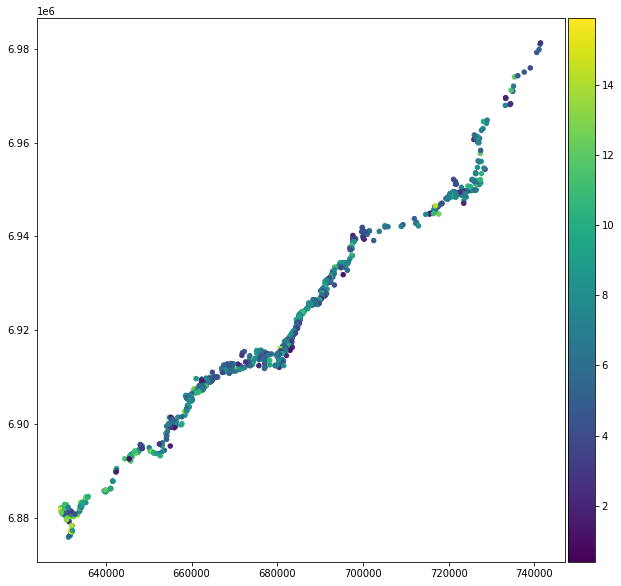

In [9]:
ax = gp.point(data,color_name="Thickness",figsize=[10,10])

In [10]:
filename = os.path.join(os.getenv('GSTLEARN_DATA'), "Oise", "Alluvial.csv")

In [11]:
csv = gl.CSVformat(False, 0, ";", ",", "9999")
poly = gl.Polygons.createFromCSV(filename, csv, True)

Data table read (Alluvial.csv) successfully
 - Number of columns = 2
 - Number of rows    = 1437
 

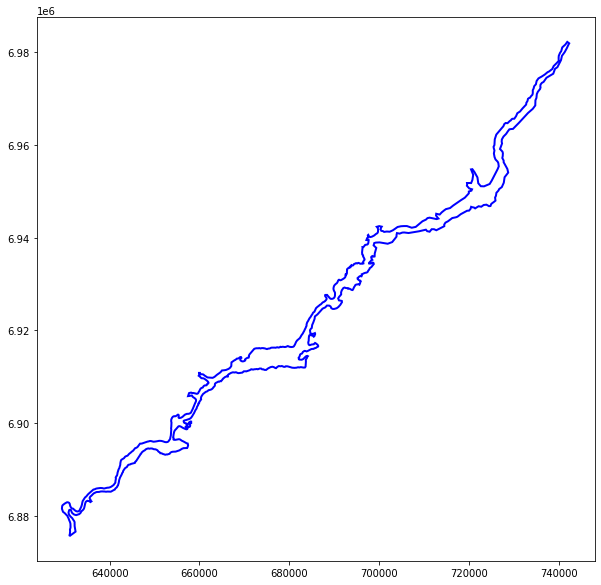

In [12]:
ax = gp.polygon(poly,figsize = [10,10])

In [13]:
grid = gl.DbGrid()
err = grid.reset([3300,400],[50,50],[630000,6865000],[40,0])

In [14]:
data


Data Base Characteristics

Data Base Summary
-----------------
File is organized as a set of isolated points
Space dimension              = 2
Number of Columns            = 7
Maximum Number of UIDs       = 7
Total number of samples      = 1022
Number of active samples     = 1007

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = X - Locator = x1
Column = 2 - Name = Y - Locator = x2
Column = 3 - Name = Epaisseur - Locator = lower1
Column = 4 - Name = Epaisseur_1 - Locator = upper1
Column = 5 - Name = Thickness - Locator = z1
Column = 6 - Name = Duplicate - Locator = sel

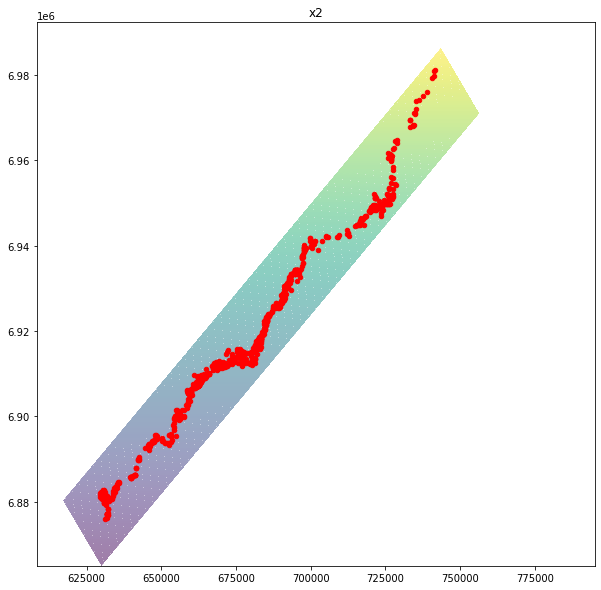

In [15]:
ax = gp.grid(grid,flagColorBar=False,alpha=0.3,figsize=[10,10])
ax = gp.point(data,ax=ax)

In [16]:
err = gl.db_polygon(grid,poly)
grid


Data Base Grid Characteristics

Data Base Summary
-----------------
File is organized as a regular grid
Space dimension              = 2
Number of Columns            = 4
Maximum Number of UIDs       = 4
Total number of samples      = 1320000
Number of active samples     = 138248

Grid characteristics:
---------------------
Origin : 630000.0006865000.000
Mesh   :     50.000    50.000
Number :       3300       400
Rotation Angles        =     40.000     0.000
Direct Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766     0.643
     [  1,]    -0.643     0.766
Inverse Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766    -0.643
     [  1,]     0.643     0.766

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = x1 - Locator = x1
Column = 2 - Name = x2 - Locator = x2
Column = 3 - Name = Polygon - Locator = sel

In [17]:
##CenterLine + échantillonnage 
xc = [631880,631843,631796,631753,631697,631640,631606,631574,631523,631491,631266,631073,630862,630664,630465,630352,630306,630258,630323,630621,630991,631413,631618,631783,631954,632204,632540,632928,633140,633319,633525,633769,633891,634042,634095,634161,634242,634296,634449,634630,634845,635043,635183,635488,635647,635861,636066,636355,636590,636761,637228,637427,637645,637863,638098,638352,638735,639187,639421,639699,640020,640304,640528,640785,641173,641313,641515,641664,641824,642002,642172,642413,642591,642770,642974,643167,643344,643485,643735,643972,644189,644517,644846,645014,645205,645415,645637,646070,646282,646431,646725,647043,647461,647615,648004,648253,648483,648843,649214,649532,649953,650404,650671,651107,651610,651995,652416,652835,653212,653450,653669,653897,653900,653903,653830,653791,653850,653911,653952,654031,654150,654349,654487,654830,655178,655458,655764,656059,656358,656715,657117,657464,657784,657975,658159,658379,658525,658800,658946,659084,659232,659390,659547,659688,659845,660079,660244,660435,660531,660821,661116,661454,661839,662193,662496,663071,663382,663721,664032,664283,664588,664918,665237,665574,665869,666324,666647,667053,667450,668207,668575,669135,669546,670300,670797,671250,671653,672023,672390,672880,673290,673714,674149,674540,675014,675393,675792,676206,676552,676901,677202,677533,677766,678096,678420,679022,679376,679828,680229,680669,680997,681423,681675,681940,682208,682375,682527,682699,682843,682976,683147,683314,683463,683632,683731,683815,683950,684088,684246,684292,684373,684557,684786,684970,685146,685358,685707,685898,686115,686356,686677,687010,687252,687497,687745,688213,688601,689061,689451,689819,690100,690321,690504,690631,690799,690999,691164,691354,691524,691651,691792,691869,692231,692629,693197,693572,693847,694198,694424,694672,694926,695155,695465,695825,696081,696421,696590,696826,697075,697270,697398,697489,697612,697738,697868,697979,698062,698077,698089,698102,698120,698132,698250,698284,698482,698884,699368,699669,699838,700192,700595,700949,701235,701499,701800,702126,702472,702629,702922,703037,703267,703457,703679,703810,704068,704304,704526,704889,705251,705438,705723,705929,706196,706578,706900,707208,707509,707784,707998,708310,708519,708755,708946,709273,709672,709996,710213,710409,710665,711057,711411,711694,712030,712372,712597,712878,713079,713343,713630,713973,714135,714280,714396,714642,714884,715182,715376,715680,715920,716120,716366,716607,716820,717102,717319,717723,717990,718205,718509,718715,719184,719361,719703,720028,720392,720751,721123,721548,721801,722203,722533,722957,723333,723764,724076,724394,724771,725135,725590,725834,726029,726188,726338,726453,726498,726673,726836,726950,727135,727233,727289,727370,727293,727217,727131,726918,726748,726608,726452,726313,726316,726318,726309,726297,726290,726418,726532,726649,726712,726774,726828,726861,727096,727252,727394,727697,727882,727959,728056,728322,728423,728643,728975,729238,729588,729837,729999,730207,730434,730639,730803,730976,731222,731464,731701,731900,732100,732272,732477,732674,732846,732969,733141,733281,733402,733469,733532,733587,733724,733977,734137,734293,734455,734574,734617,734666,734780,734868,735117,735200,735286,735397,735486,735571,735756,736072,736342,736625,736919,737125,737393,737641,737968,738288,738668,738740,738798,738910,739013,739273,739604,739736,739890,740015,740247,740266,740335,740413,740527,740732,740910,740984,741172,741329,741467,741678,741809,741926,742113]
yc = [6876232,6876495,6876828,6877135,6877532,6877919,6878137,6878336,6878666,6878869,6879272,6879617,6879946,6880255,6880569,6880746,6880990,6881252,6881667,6881767,6881644,6881403,6881247,6881121,6880944,6880686,6880546,6880558,6880658,6880742,6881012,6881332,6881599,6881927,6882137,6882401,6882720,6882934,6883142,6883387,6883645,6883883,6884051,6884320,6884461,6884650,6884830,6885077,6885278,6885424,6885590,6885588,6885586,6885584,6885582,6885580,6885577,6885573,6885571,6885632,6885704,6885766,6885982,6886228,6886600,6886937,6887422,6887782,6888168,6888595,6889011,6889599,6890055,6890557,6890884,6891185,6891480,6891717,6892136,6892325,6892498,6892760,6892890,6892956,6893032,6893150,6893276,6893659,6893858,6893999,6894249,6894520,6894806,6894915,6895052,6895140,6895221,6895199,6895178,6895159,6895134,6895107,6895092,6895066,6895036,6895013,6894988,6894964,6894941,6894905,6895120,6895344,6895688,6896032,6896562,6896849,6897225,6897614,6897880,6898251,6898810,6899130,6899352,6899632,6899918,6900148,6900398,6900640,6900885,6901067,6901272,6901374,6901469,6901660,6901843,6902087,6902355,6902859,6903170,6903520,6903897,6904296,6904693,6905051,6905374,6905853,6906189,6906580,6906776,6906988,6907203,6907450,6907730,6907988,6908209,6908661,6908905,6909172,6909416,6909613,6909853,6910112,6910363,6910628,6910859,6911152,6911361,6911623,6911751,6911997,6912117,6912299,6912432,6912622,6912748,6912862,6912964,6913057,6913149,6913273,6913420,6913571,6913726,6913866,6914035,6914171,6914313,6914461,6914584,6914709,6914816,6914935,6914970,6915021,6915070,6915162,6915215,6915284,6915345,6915412,6915462,6915527,6915716,6915915,6916116,6916242,6916564,6916930,6917235,6917517,6917982,6918438,6918794,6919200,6919509,6919772,6920195,6920452,6920745,6920963,6921349,6921711,6922164,6922561,6922933,6923370,6923645,6923931,6924184,6924466,6924809,6925147,6925392,6925641,6925733,6925907,6926052,6926223,6926368,6926504,6926609,6926882,6927109,6927380,6927741,6928179,6928539,6928955,6929324,6929603,6929911,6930079,6930301,6930545,6930894,6931124,6931292,6931508,6931680,6931869,6932062,6932237,6932473,6932747,6932942,6933201,6933589,6934130,6934699,6935146,6935439,6935647,6935929,6936218,6936514,6936769,6936959,6937278,6937514,6937781,6938166,6938410,6938773,6939061,6939392,6939542,6939715,6939819,6939878,6939944,6940019,6939963,6939918,6939876,6939885,6939894,6940019,6940075,6940428,6940700,6940883,6941034,6941267,6941404,6941449,6941490,6941509,6941540,6941573,6941590,6941615,6941634,6941592,6941531,6941480,6941533,6941585,6941633,6941670,6941724,6941760,6941951,6942106,6942372,6942492,6942589,6942654,6942713,6942732,6942762,6942818,6942863,6942916,6942833,6942779,6942795,6942934,6943118,6943328,6943592,6943812,6944009,6944166,6944387,6944604,6944801,6944929,6945129,6945212,6945281,6945366,6945449,6945523,6945725,6945880,6946169,6946347,6946491,6946656,6946768,6947022,6947126,6947326,6947516,6947730,6947940,6948158,6948407,6948555,6948790,6948984,6949232,6949452,6949704,6949887,6950073,6950294,6950508,6950774,6951074,6951313,6951509,6951879,6952276,6952568,6952957,6953319,6953572,6953983,6954199,6954583,6955129,6955489,6955844,6956252,6956685,6957056,6957375,6957733,6958218,6958469,6958758,6958985,6959271,6959448,6959804,6960122,6960446,6960732,6961009,6961250,6961401,6961776,6962025,6962253,6962555,6962823,6963019,6963265,6963580,6963751,6963903,6964066,6964195,6964368,6964491,6964571,6964743,6964931,6965166,6965354,6965552,6965812,6966066,6966339,6966568,6966777,6966957,6967171,6967377,6967556,6967685,6967865,6968011,6968138,6968388,6968628,6968836,6969027,6969381,6969581,6969944,6970188,6970365,6970691,6971052,6971301,6971706,6972008,6972310,6972619,6972741,6973074,6973390,6973627,6973922,6974128,6974344,6974627,6974782,6974983,6975116,6975292,6975504,6975754,6975949,6976106,6976360,6976594,6976810,6977086,6977309,6977569,6977779,6978104,6978569,6978883,6979236,6979456,6979851,6980187,6980441,6980701,6980919,6981110,6981384,6981554,6981706,6981949]

x1=xc[1:499]
y1=yc[1:499] 
np.shape(x1)

## Données contours alluvial Plain 
xp=[631065,631083,631145,631200,631169,631186,631265,631292,631279,631252,631161,631011,630893,630791,630680,630572,630225,630048,629614,629381,629414,629460,629508,629652,629866,630054,630280,630496,630604,630748,630911,631009,631120,631149,631265,631459,631649,631883,632061,632336,632579,632797,632992,633127,633244,633461,633684,633832,633909,633995,634171,634517,634821,635145,635452,636176,636392,636645,637013,637314,637956,638332,638706,638837,639162,639481,639565,639836,640104,640403,640674,640835,640997,641246,641283,641298,641359,641401,641353,641420,641529,641621,641693,641781,641844,641990,642180,642241,642312,642372,642389,642487,642582,642688,643186,643461,643660,643998,644371,644472,644738,644944,645200,645412,645675,645976,646227,646761,647163,647304,648453,648603,649014,649279,649594,649794,650099,650505,651016,651452,651601,651876,652286,652431,652701,652906,652987,653087,653209,653315,653416,653473,653519,653632,653686,653727,653693,653694,653731,653748,653775,653719,653711,653778,653913,654072,654147,654368,654553,654708,654879,655026,655226,655316,655361,655395,655383,655357,655476,655571,655732,655952,656244,656526,656673,656848,656953,657064,657149,657299,657470,657640,657876,658102,658503,659035,659221,659248,659189,659025,658766,658636,658482,658453,658309,658204,657791,657467,657682,657927,658178,658403,658483,658668,658858,659408,659518,659684,659739,659770,659882,660008,660145,660289,660483,660714,660795,660901,661046,661187,661463,661603,661690,661801,661931,662027,661949,661777,661418,661063,660783,660598,660433,660214,660031,659876,659982,659943,659924,659906,660106,660120,660240,660404,660784,660949,661103,661761,661826,662911,663082,663388,663892,664231,664556,664807,665013,665554,665924,666513,666855,667095,667132,667838,667965,668159,668337,668492,668730,668966,669126,669275,669344,669199,669095,669110,669179,669404,669528,669684,669949,670190,670161,670203,670312,670468,670649,670753,670939,671043,671016,671129,671649,672091,672206,672296,672435,672652,673159,673280,673336,673632,673831,674193,674387,674524,674956,675067,675333,675533,675709,675973,676052,676268,676786,676921,676982,677276,677335,677395,677475,677582,677655,677789,677893,678012,678060,678166,678235,678370,678470,678625,678973,679082,679304,679434,679581,679651,679722,680066,680194,680379,680716,680849,680993,681077,681134,681183,681260,681341,681398,681494,681574,681646,681741,682090,682223,682344,682432,682519,682665,682736,683012,683189,683207,683360,683419,683497,683681,683722,683845,683858,683851,683853,683888,683939,683990,684053,684113,684218,684289,684338,684489,684528,684595,684758,684816,684885,684958,685036,685126,685185,685224,685290,685373,685485,685606,685658,685679,685716,685777,685817,685934,686087,686305,686637,686816,686960,687117,687395,687497,687695,687882,688019,688070,688223,688310,688319,688289,688202,688084,688012,687994,687985,688099,688137,688432,688677,688911,689003,689131,689292,689432,689624,689789,689890,690006,690118,690174,690188,690183,690199,690177,690129,690031,689971,689923,689856,689848,689867,689904,689955,690008,690115,690298,690489,690554,690635,690763,690868,690925,691024,691066,691114,691189,691262,691318,691436,691601,691919,692132,692320,692400,692498,692528,692546,692539,692505,692547,692619,692676,692743,692816,692855,692835,692837,692871,692884,692871,692805,692762,692855,692917,692976,693076,693219,693399,693434,693505,693571,693633,693657,693657,693658,693673,693821,693849,694013,694116,694211,694262,694325,694384,694435,694502,694551,694680,694749,694794,694859,694903,694965,695027,695098,695193,695334,695399,695461,695593,695714,695827,695914,696003,696070,696200,696278,696384,696473,696497,696525,696503,696439,696400,696440,696484,696595,696751,696772,696721,696589,696448,696456,696434,696319,696317,696249,696216,696249,696330,696308,696513,696770,696905,697406,697534,697622,697633,697691,697653,697546,697271,697184,697352,697555,697550,697494,697597,697649,697742,697808,698086,698444,698930,699281,699610,699762,699788,699678,699495,700034,700594,700483,700316,700503,700862,701125,701723,702378,703063,703686,704122,704879,705533,706204,707280,708166,709673,710445,710780,711258,711876,712812,713211,713029,712689,712731,713496,713963,714471,714886,715807,716514,718267,719095,719984,719988,720569,720706,720099,719555,719616,719577,720114,720506,720784,720963,720487,720782,721253,721908,722093,722657,723374,724631,725087,726415,726656,726562,726412,725932,725717,725572,725697,725549,725496,725691,725766,726109,727473,727666,727910,728195,728614,729115,729339,729535,729700,730122,730515,730790,731388,731967,732216,732750,732813,732908,733053,733162,733375,733630,733803,734147,734218,734239,734229,734415,734547,734930,735084,735219,735503,736256,736877,737536,737816,738578,738880,739536,740007,739985,740021,740292,740565,740795,741086,741488,741911,742345,742176,741805,741329,740723,740526,740348,739711,739185,738796,737289,736634,736256,735964,735904,735966,735860,735362,735133,735042,734824,734788,734237,733169,732455,731148,730173,729828,729406,729023,728684,728315,728179,727709,727340,727308,727391,726934,727475,727575,727542,727447,727447,727745,727750,727874,728570,728755,727954,727775,727335,726732,726596,726126,726097,726023,725840,725922,725640,725124,724983,724807,724488,723909,723300,722766,722159,721395,721129,720811,720505,720370,720044,719599,718193,717451,717113,716305,715347,714787,714515,714524,712753,712236,711721,711260,710716,710425,708927,706574,705573,705157,704576,703989,703906,703881,703522,703256,702936,701929,700122,699293,698935,698788,699381,699040,699007,698859,698691,698500,698285,698249,698370,698496,698317,697756,697766,697939,698258,698397,698549,698742,698830,698293,697911,697824,697607,697451,697233,696976,696675,696383,696139,696171,696086,695874,695664,695208,695252,695546,695830,695929,695831,695770,695621,695402,695131,694915,694743,694554,694429,694275,694105,693849,693685,693394,693122,693032,692659,692327,692058,691701,691548,691565,691460,691094,690896,691059,691699,691743,691379,690945,690564,690022,689716,689377,689212,688917,688394,688022,687418,687032,686278,685710,685644,685336,685105,685015,684803,684621,684699,684840,685304,685712,685775,685609,685458,685288,684942,684605,684449,684379,684349,684327,684230,684270,684339,684484,684671,684928,685213,685463,685582,685747,685852,686314,686458,686386,686197,685872,685613,685431,685172,684919,684529,684169,683859,683593,683376,683028,682867,682573,682422,682277,682089,682151,682299,682783,683098,683501,683733,684011,684148,683967,683904,683685,683712,683638,683486,683167,682709,682583,682207,681971,681594,681128,680617,680285,679723,679569,679234,679085,678852,678675,678462,678322,678128,677968,677789,677693,677609,677153,677099,677068,677017,676959,676832,676550,676247,675881,675313,674846,674613,674453,674262,673965,673766,673440,673002,672777,672494,672210,671937,671761,671528,671218,670442,670338,669878,669562,668753,668456,668265,668106,667825,667665,667437,667052,666534,666416,666312,666269,666291,666347,666341,666274,666217,666137,666038,665946,665811,665656,665400,665284,665248,665228,665101,665050,664831,664793,664748,664683,664614,664549,664487,664446,664396,664371,664286,664236,664181,664122,664035,663973,663739,663679,663535,663487,663452,663442,663441,663450,663435,663409,663343,663257,663152,663051,662960,662840,662713,662623,662512,662256,662136,662061,661996,661814,661709,661558,661413,660990,660874,660809,660748,660667,660561,660455,660399,660332,660321,660326,660380,660365,660274,660228,660026,659986,659955,659949,659923,659898,659793,659753,659722,659722,659746,659726,659472,659422,659421,659401,659401,659380,659339,659147,659031,658848,658731,658544,658518,658439,658351,658240,658129,658003,657961,657857,657767,657637,657491,657446,657356,657155,656979,656924,656673,656548,656498,656482,656501,656531,656570,656625,656679,656814,656889,656964,657014,657044,657103,657138,657158,657213,657258,657313,657408,657443,657479,657538,657615,657616,657777,657883,658003,658068,658158,658166,658137,658117,658020,657955,657904,657899,657903,657928,657937,657936,657916,657916,657850,657805,657744,657679,657629,657553,657435,657370,657280,657210,657009,656949,656924,656919,656938,656983,657043,657088,657113,657243,657328,657367,657372,657362,657331,657276,657195,657145,657065,656985,656846,656740,656270,655913,655668,655478,655303,655045,654813,654645,654533,654424,654363,654229,654228,654191,654160,654140,654144,654174,654258,654263,654230,654207,654241,654321,654556,654736,655368,655598,655807,656031,656450,657163,657393,657480,657373,657261,656415,656269,656144,655958,655546,654713,654037,653977,653811,653706,653570,653504,653439,653388,653349,653283,653214,653120,653049,652925,652844,652777,652686,652424,652345,652291,652181,652108,651995,651902,651828,651773,651656,651528,651416,651285,651266,651236,651183,651102,651004,650909,650782,650690,650626,650527,650367,650277,650197,650062,649887,649717,649603,649498,649378,649201,649088,648872,648822,648652,648592,648430,648319,648141,648006,647981,647839,647668,647538,647436,647138,647024,646962,646867,646807,645876,645800,645664,645654,645618,644743,644650,644480,644315,644163,644020,643821,643761,643531,643366,643270,643080,643000,642973,642931,642867,642784,642705,642489,642318,642109,642102,642038,641967,641925,641869,641824,641716,641617,641321,641244,641155,641018,640617,640360,640208,640038,639529,639196,638759,638613,638349,637993,637660,637326,637155,637042,636903,636665,636527,636436,636247,636008,635878,635716,635589,635556,635569,635611,635721,635761,635824,635868,635945,635723,635668,635598,635399,635220,635031,634889,634776,634681,634615,634565,634413,634347,634242,634089,633852,633765,633703,633631,633520,633444,633339,633248,633138,633069,632933,632799,632724,632546,632103,631686,631567,631421,631293,631112,631021,630961,630911,630856,630861,630945,631050,631174,631268,631355,631461,631641,631731,631810,631907,632059,632137,632192,632202,632195,632206,632205,632413]
yp=[6875650,6875930,6876080,6876700,6877010,6877130,6877380,6877550,6878240,6878410,6878710,6879040,6879350,6879600,6879790,6880040,6880360,6880560,6880890,6881540,6881960,6882180,6882270,6882400,6882560,6882690,6882820,6882930,6882940,6882920,6882850,6882780,6882600,6882420,6882040,6881730,6881600,6881550,6881380,6881150,6881010,6880960,6880980,6881020,6881100,6881530,6881980,6882440,6882830,6883180,6883450,6883970,6884210,6884610,6884890,6885500,6885680,6885730,6885890,6885940,6886020,6886000,6885910,6885920,6886000,6886080,6886070,6886100,6886180,6886320,6886520,6886610,6886810,6887130,6887240,6887530,6887800,6888050,6888290,6888410,6888600,6888660,6888860,6889370,6889560,6890020,6890350,6890620,6890800,6891030,6891370,6891830,6892050,6892140,6892430,6892770,6892870,6892990,6893400,6893470,6893670,6893860,6894030,6894270,6894590,6894690,6894870,6895570,6895590,6895640,6896020,6896040,6896150,6896120,6896030,6895990,6896020,6896080,6896180,6896170,6896140,6896070,6895930,6895900,6895890,6895940,6895980,6896060,6896220,6896380,6896480,6896610,6896870,6897340,6898100,6898650,6898790,6898930,6899180,6899550,6900140,6900300,6900680,6900900,6901170,6901360,6901410,6901500,6901460,6901500,6901590,6901700,6901830,6901800,6901750,6901610,6901390,6901210,6901090,6901100,6901130,6901190,6901360,6901620,6901740,6901870,6901890,6901950,6901980,6902000,6902000,6902020,6902100,6902250,6903040,6904300,6904680,6904970,6905130,6905310,6905500,6905560,6905700,6905780,6905930,6905950,6905860,6905820,6906460,6906540,6906570,6906450,6906470,6906490,6906450,6906310,6906330,6906420,6906490,6906580,6906780,6906950,6907260,6907450,6907590,6907650,6907750,6907930,6908060,6908120,6908130,6908170,6908390,6908470,6908510,6908680,6908860,6909060,6909340,6909580,6909670,6909660,6909690,6909900,6910080,6910180,6910260,6910440,6910590,6910820,6910820,6910700,6910590,6910540,6910510,6910420,6910280,6909860,6909840,6909760,6909820,6909990,6910410,6910640,6910860,6911090,6911350,6911400,6911460,6911700,6911960,6912310,6913090,6913570,6913610,6913750,6913900,6913910,6913960,6914160,6914240,6914220,6914060,6913940,6913810,6913580,6913480,6913350,6913310,6913300,6913360,6913500,6913710,6913770,6913860,6913950,6914060,6914090,6914100,6914330,6914520,6914790,6915380,6915880,6916010,6916040,6916080,6916130,6916130,6916170,6916160,6916090,6916160,6916170,6916110,6916120,6915970,6915960,6916060,6916070,6916110,6916250,6916260,6916270,6916270,6916250,6916250,6916340,6916340,6916340,6916310,6916280,6916290,6916310,6916360,6916450,6916440,6916410,6916400,6916430,6916450,6916450,6916400,6916400,6916450,6916500,6916580,6916600,6916590,6916440,6916440,6916390,6916420,6916440,6916520,6916610,6916740,6916790,6916920,6917090,6917220,6917440,6917580,6917670,6917810,6918100,6918210,6918300,6918450,6918570,6918840,6918950,6919310,6919640,6919670,6919920,6920080,6920240,6920580,6920740,6920950,6921080,6921150,6921250,6921390,6921560,6921690,6921810,6921900,6922040,6922210,6922270,6922570,6922620,6922690,6922900,6922980,6923120,6923240,6923330,6923440,6923550,6923670,6923760,6923860,6923910,6924020,6924080,6924180,6924290,6924360,6924430,6924740,6924890,6925080,6925320,6925490,6925550,6925670,6925960,6926040,6926110,6926250,6926320,6926410,6926560,6926730,6926820,6926950,6927110,6927250,6927350,6927390,6927580,6927630,6927630,6927630,6927320,6927090,6926960,6926850,6926780,6926780,6926800,6926860,6926920,6927030,6927220,6927440,6927620,6927730,6928010,6928130,6928240,6928410,6928520,6928630,6928880,6929010,6929150,6929330,6929500,6929620,6929760,6929940,6930090,6930130,6930210,6930420,6930680,6930770,6930880,6930900,6930900,6930870,6930810,6930790,6930790,6930850,6931030,6931160,6931300,6931380,6931530,6931590,6931750,6931830,6931890,6932020,6931960,6931980,6932070,6932220,6932430,6932600,6932650,6932840,6932980,6933030,6933120,6933150,6933170,6933190,6933240,6933360,6933450,6933590,6933560,6933550,6933560,6933580,6933620,6933730,6933800,6933900,6934010,6933960,6933950,6933970,6934000,6934040,6934130,6934230,6934280,6934320,6934340,6934370,6934410,6934440,6934470,6934480,6934460,6934430,6934420,6934430,6934520,6934530,6934520,6934470,6934390,6934350,6934350,6934370,6934360,6934390,6934360,6934330,6934300,6934260,6934440,6934520,6934600,6934630,6934730,6934760,6935030,6935180,6935300,6935440,6935700,6935910,6936080,6936150,6936280,6936330,6936400,6936810,6937110,6937860,6937930,6937940,6938240,6938410,6938500,6938630,6938860,6939090,6939430,6939540,6939530,6939450,6939460,6939890,6940040,6940200,6940470,6940570,6940480,6940230,6940180,6940100,6940200,6940450,6940740,6940930,6941200,6941740,6942100,6942310,6942460,6942340,6942160,6941790,6941440,6941380,6941210,6941290,6941250,6941550,6941970,6942270,6942430,6942470,6942470,6942110,6942290,6943510,6943860,6944180,6944280,6944160,6943970,6944090,6944290,6944750,6945120,6944950,6945430,6945830,6946120,6946350,6946900,6948070,6948580,6949510,6949910,6950100,6950390,6950570,6951160,6951380,6951750,6951750,6951740,6952400,6953530,6954680,6954730,6954100,6952960,6951700,6951060,6951030,6951540,6952260,6954760,6955340,6956030,6956340,6956830,6957350,6958120,6958760,6959250,6959540,6959940,6961160,6962190,6963750,6963950,6964480,6964680,6964650,6965120,6965250,6965500,6965590,6965610,6966160,6966790,6967160,6967840,6968100,6968650,6969070,6969200,6969430,6969890,6970050,6970150,6970420,6970770,6971000,6971300,6971750,6972110,6972610,6973030,6973730,6973920,6974300,6974720,6975110,6975640,6975760,6976320,6976950,6977580,6978070,6978730,6979160,6979790,6980170,6980970,6981240,6981590,6982160,6981850,6981560,6980790,6979950,6979150,6978260,6977910,6976710,6976360,6975310,6974440,6973540,6973330,6972970,6972570,6972390,6972020,6971410,6970920,6970080,6969590,6968460,6967740,6966840,6966090,6964720,6963760,6963410,6963380,6963320,6962900,6962360,6962220,6961760,6961130,6960620,6960280,6959070,6958520,6958180,6957560,6957140,6957140,6956590,6956200,6956010,6954780,6953990,6952990,6951810,6950870,6950430,6950130,6949630,6949400,6948980,6948620,6947950,6947720,6947350,6947230,6946790,6946760,6947080,6947010,6946640,6946740,6946280,6946470,6946520,6946620,6946170,6945800,6945770,6945030,6944480,6944360,6944200,6943500,6943210,6942800,6942440,6941570,6941790,6941790,6941250,6941370,6941690,6941350,6940970,6941090,6941060,6940840,6940960,6940640,6940190,6939730,6939420,6939020,6938660,6938950,6938910,6938810,6938310,6937760,6936570,6935920,6935880,6935890,6936010,6935850,6935690,6935380,6935190,6935120,6934510,6934410,6934380,6934410,6934530,6934610,6934540,6934290,6933640,6933380,6933120,6932880,6932580,6932440,6932410,6932310,6932170,6932080,6931810,6931640,6931690,6931640,6931250,6931030,6930790,6930700,6930560,6930390,6930140,6929830,6929940,6929890,6929860,6929780,6929460,6929300,6928940,6928680,6928720,6928840,6928980,6928950,6929100,6929100,6929220,6929120,6928630,6928180,6927760,6927600,6927200,6926890,6926460,6926340,6926070,6925500,6925030,6924760,6924610,6924600,6924760,6925130,6925320,6925340,6924940,6924670,6924240,6923430,6922990,6922470,6921650,6921150,6920510,6920320,6920030,6919360,6919250,6919230,6919400,6919210,6918760,6918630,6918800,6918930,6918980,6918890,6918590,6918230,6917740,6917430,6917100,6916930,6916810,6916820,6916930,6916970,6916990,6917120,6917280,6917230,6916890,6916600,6916470,6916390,6916180,6916130,6916000,6915990,6915960,6915760,6915570,6915450,6915550,6915560,6915330,6915020,6914900,6914780,6914310,6914090,6913750,6913690,6913660,6913800,6914190,6914400,6914490,6914420,6914200,6913970,6913670,6913270,6912180,6911980,6911970,6912050,6912070,6911990,6912040,6911940,6911910,6911950,6912050,6912210,6912240,6912250,6912150,6912120,6912170,6912270,6912300,6912260,6912250,6912290,6912300,6912280,6911960,6911860,6911840,6911840,6911860,6911910,6912070,6912150,6912080,6911810,6911460,6911470,6911480,6911590,6911590,6911750,6911770,6911600,6911660,6911620,6911600,6911530,6911570,6911610,6911410,6911150,6911170,6911160,6910890,6910770,6910820,6910920,6910960,6910910,6910930,6910950,6910830,6910540,6910440,6910330,6910240,6910160,6910070,6910040,6910020,6910030,6910040,6910040,6910030,6909980,6909900,6909690,6909610,6909560,6909510,6909400,6909290,6909050,6909070,6909090,6909080,6909030,6908990,6908960,6908940,6908920,6908920,6908950,6908960,6908940,6908900,6908850,6908820,6908710,6908680,6908560,6908510,6908430,6908390,6908270,6908200,6908110,6908040,6907940,6907850,6907760,6907630,6907500,6907390,6907300,6907250,6907210,6907130,6907120,6907100,6907070,6906910,6906840,6906780,6906740,6906410,6906340,6906280,6906190,6906090,6905920,6905780,6905660,6905360,6905260,6905220,6905150,6905100,6904970,6904890,6904650,6904570,6904490,6904350,6904290,6904270,6904250,6904210,6904130,6904090,6904010,6903940,6903520,6903420,6903400,6903310,6903280,6903190,6903110,6902850,6902640,6902250,6902050,6901760,6901710,6901570,6901450,6901280,6901150,6901040,6901010,6900950,6900910,6900850,6900810,6900800,6900770,6900700,6900650,6900640,6900580,6900530,6900480,6900410,6900310,6900220,6900150,6900070,6900030,6900000,6899990,6899980,6899950,6899900,6899740,6899710,6899710,6899790,6899810,6899800,6899770,6899770,6899790,6899890,6900030,6900050,6900220,6900290,6900340,6900350,6900330,6900030,6900020,6900020,6899920,6899870,6899790,6899750,6899710,6899620,6899540,6899430,6899350,6899340,6899240,6899200,6899180,6899180,6899200,6899250,6899310,6899320,6899320,6899320,6899290,6899260,6899230,6899190,6899140,6899090,6899070,6899060,6899060,6899040,6899020,6898970,6898930,6898860,6898790,6898720,6898680,6898670,6898670,6898690,6898770,6898780,6899000,6899220,6899320,6899350,6899280,6898990,6898730,6898560,6898440,6898250,6898090,6897480,6897410,6897080,6897030,6896950,6896910,6896860,6896750,6896700,6896620,6896500,6896440,6896410,6896390,6896410,6896530,6896510,6896400,6896230,6896040,6895650,6895600,6895220,6894860,6894630,6894600,6894520,6894490,6894370,6894130,6893860,6893830,6893810,6893780,6893730,6893650,6893590,6893510,6893420,6893390,6893360,6893350,6893330,6893300,6893260,6893240,6893250,6893250,6893190,6893200,6893210,6893260,6893280,6893310,6893330,6893360,6893410,6893450,6893490,6893500,6893510,6893570,6893620,6893670,6893720,6893790,6893830,6893970,6894100,6894160,6894210,6894290,6894330,6894350,6894360,6894370,6894410,6894480,6894510,6894530,6894530,6894530,6894490,6894490,6894540,6894550,6894500,6894470,6894400,6894310,6894270,6894150,6894050,6893990,6893910,6893660,6893420,6893370,6893310,6893170,6891780,6891750,6891600,6891470,6891420,6891200,6891130,6891070,6891050,6891000,6890830,6890520,6890480,6890360,6890210,6890050,6889800,6889650,6889480,6889390,6889330,6889190,6888970,6888570,6888270,6887660,6887530,6887190,6886920,6886820,6886590,6886520,6886410,6886180,6885940,6885840,6885680,6885620,6885410,6885260,6885220,6885230,6885250,6885210,6885270,6885260,6885280,6885260,6885170,6885160,6885150,6885130,6885070,6884950,6884900,6884830,6884660,6884420,6884300,6884180,6883990,6883890,6883730,6883630,6883530,6883410,6883280,6883210,6883140,6882980,6883020,6883140,6883180,6883220,6883260,6883180,6883110,6883010,6882850,6882700,6882040,6881750,6881500,6881310,6881100,6881040,6880970,6880850,6880640,6880570,6880480,6880410,6880340,6880340,6880300,6880240,6880240,6880170,6880290,6880600,6880780,6881170,6881300,6881310,6881270,6881140,6880980,6880760,6880630,6880350,6880170,6880010,6879900,6879810,6879710,6879550,6879430,6879300,6879150,6878950,6878820,6878660,6878600,6878410,6878200,6877830,6876610]
x2=xp[1:xp.index(max(xp))]
x3=xp[len(xp):xp.index(max(xp))+1:-1]
y2=yp[1:xp.index(max(xp))]
y3=yp[len(xp):xp.index(max(xp))+1:-1]

## Points de contrôle supplémentaires
# coordonnées points extrêmes
XA1=640000
YA1=6875000
XB1=740000
YB1=6955000

XA2=630000
YA2=6890000
XB2=735000
YB2=6980000

# ajouts de deux zones de vecteurs supplementaires => limites de l'interpolation
n=19
x4= np.zeros(n)
y4= np.zeros(n)
x5= np.zeros(n)
y5= np.zeros(n)
for i in range(0,len(x4)):
    x4[i]=(XA1+(XB1-XA1)/(n-1)*i)
    y4[i]=(YA1+(YB1-YA1)/(n-1)*i)
    x5[i]=(XA2+(XB2-XA2)/(n-1)*i)
    y5[i]=(YA2+(YB2-YA2)/(n-1)*i)

# Methode du gradient 
#  https://stackoverflow.com/questions/28269379/curve-curvature-in-numpy
dx_dt1 = np.gradient(x1)
dy_dt1 = np.gradient(y1)
velocity = np.array([ [dx_dt1[i], dy_dt1[i]] for i in range(dx_dt1.size)])
ds_dt1 = np.sqrt(dx_dt1 * dx_dt1 + dy_dt1 * dy_dt1)
tangent1 = np.array([1/ds_dt1] * 2).transpose() * velocity

dx_dt2 = np.gradient(x2)
dy_dt2 = np.gradient(y2)
velocity2 = np.array([ [dx_dt2[i], dy_dt2[i]] for i in range(dx_dt2.size)])
ds_dt2 = np.sqrt(dx_dt2 * dx_dt2 + dy_dt2 * dy_dt2)
tangent2 = np.array([1/ds_dt2] * 2).transpose() * velocity2

dx_dt3 = np.gradient(x3)
dy_dt3 = np.gradient(y3)
velocity3 = np.array([ [dx_dt3[i], dy_dt3[i]] for i in range(dx_dt3.size)])
ds_dt3 = np.sqrt(dx_dt3 * dx_dt3 + dy_dt3 * dy_dt3)
tangent3 = np.array([1/ds_dt3] * 2).transpose() * velocity3

dx_dt4 = np.gradient(x4)
dy_dt4 = np.gradient(y4)
velocity4 = np.array([ [dx_dt4[i], dy_dt4[i]] for i in range(dx_dt4.size)])
ds_dt4 = np.sqrt(dx_dt4 * dx_dt4 + dy_dt4 * dy_dt4)
tangent4 = np.array([1/ds_dt4] * 2).transpose() * velocity4

dx_dt5 = np.gradient(x5)
dy_dt5 = np.gradient(y5)
velocity5 = np.array([ [dx_dt5[i], dy_dt5[i]] for i in range(dx_dt5.size)])
ds_dt5 = np.sqrt(dx_dt5 * dx_dt5 + dy_dt5 * dy_dt5)
tangent5 = np.array([1/ds_dt5] * 2).transpose() * velocity5

tangent=np.concatenate((tangent1,tangent2,tangent3,tangent4,tangent5),axis=0) 

x0=np.concatenate((x1,x2,x3,x4,x5),axis=0) 
y0=np.concatenate((y1,y2,y3,y4,y5),axis=0) 
u0 = tangent[:, 0]
v0 = tangent[:, 1]


#fig, ax = plt.subplots(figsize = (100,100))
#plt.figure(1)
#plt.quiver(x0,y0,u0,v0)

#plt.plot(x0,y0,'ro')


In [18]:
# Methode d'interpolation -> https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.griddata.html

xx = np.linspace(629000, 742000, 200)
yy = np.linspace(6875000, 6982160, 200)
xx, yy = np.meshgrid(xx, yy)

u0.shape=(np.size(u0),)
np.shape(u0)
v0.shape=(np.size(v0),)
np.shape(v0)

points = np.transpose(np.vstack((x0, y0)))
u_interp = interpolate.griddata(points, u0, (xx, yy), method='linear')
v_interp = interpolate.griddata(points, v0, (xx, yy), method='linear')


In [19]:
plt.figure(figsize=(200,200))
plt.quiver(xx, yy, u_interp, v_interp, label='Field vectors')
plt.plot(x0,y0,'ro',markersize=20, label='Alluvial plain')

In [20]:
xx1 = np.concatenate(xx)
yy1 = np.concatenate(yy)
u_interp1 = np.concatenate(u_interp)
v_interp1 = np.concatenate(v_interp)

In [21]:
#Créer une Db point avec xx, yy, u_interp, v_interp
dbv = gl.Db()
dbv.addColumns(xx1,"xx",gl.ELoc.X, 0)
dbv.addColumns(yy1,"yy",gl.ELoc.X, 1)
dbv.addColumns(u_interp1,"u_interp",gl.ELoc.Z, 0)
dbv.addColumns(v_interp1,"v_interp",gl.ELoc.Z, 1)
dbv.display()
grid.setLocator("Pol*")
grid.display()


Data Base Characteristics

Data Base Summary
-----------------
File is organized as a set of isolated points
Space dimension              = 2
Number of Columns            = 4
Maximum Number of UIDs       = 4
Total number of samples      = 40000

Variables
---------
Column = 0 - Name = xx - Locator = x1
Column = 1 - Name = yy - Locator = x2
Column = 2 - Name = u_interp - Locator = z1
Column = 3 - Name = v_interp - Locator = z2
 
Data Base Grid Characteristics

Data Base Summary
-----------------
File is organized as a regular grid
Space dimension              = 2
Number of Columns            = 4
Maximum Number of UIDs       = 4
Total number of samples      = 1320000

Grid characteristics:
---------------------
Origin : 630000.0006865000.000
Mesh   :     50.000    50.000
Number :       3300       400
Rotation Angles        =     40.000     0.000
Direct Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766     0.643
     [  1,]    -0.643     0.766
Inverse Rotation Matrix


In [22]:
#Tester la valeur retournée par migrate :
grid.deleteColumn("Migr*")
grid.display()
gl.migrate(dbv, grid, "u_interp")
gl.migrate(dbv, grid, "v_interp")
grid.setLocator("Migrate*", gl.ELoc.Z)
#grid.display(sf)


Data Base Grid Characteristics

Data Base Summary
-----------------
File is organized as a regular grid
Space dimension              = 2
Number of Columns            = 4
Maximum Number of UIDs       = 4
Total number of samples      = 1320000

Grid characteristics:
---------------------
Origin : 630000.0006865000.000
Mesh   :     50.000    50.000
Number :       3300       400
Rotation Angles        =     40.000     0.000
Direct Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766     0.643
     [  1,]    -0.643     0.766
Inverse Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766    -0.643
     [  1,]     0.643     0.766

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = x1 - Locator = x1
Column = 2 - Name = x2 - Locator = x2
Column = 3 - Name = Polygon - Locator = NA
 

In [23]:
grid.useSel = False
grid.setLocator("Polygon")
iuid = grid.addSelectionByLimit("*u_interp*", gl.Limits([-10], [10]), "vec_define")

In [24]:
xplt = grid.getColumnByLocator(gl.ELoc.X,0,useSel=True)
yplt = grid.getColumnByLocator(gl.ELoc.X,1,useSel=True)
uplt = grid.getColumnByLocator(gl.ELoc.Z,0,useSel=True)
vplt = grid.getColumnByLocator(gl.ELoc.Z,1,useSel=True)

In [25]:
plt.figure(figsize=(200,200))
plt.quiver(xplt, yplt, uplt, vplt, label='Field vectors')
plt.plot(x0,y0,'ro',markersize=20, label='Alluvial plain')

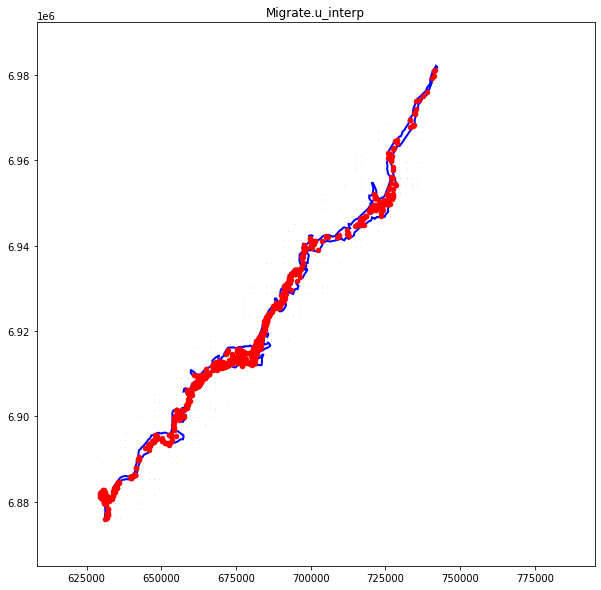

In [26]:
ax = gp.grid(grid,flagColorBar=False,alpha=0.3,figsize=[10,10],usesel=False)
ax = gp.polygon(poly,ax=ax)
ax = gp.point(data,ax=ax)


Variogram characteristics
Number of variable(s)       = 1
Number of direction(s)      = 2
Space dimension             = 2
Variance-Covariance Matrix     8.308

Direction #1
------------
Number of lags              = 40
Direction coefficients      =      1.000     1.000
Direction angles (degrees)  =     45.000     0.000
Tolerance on direction      =     45.000 (degrees)
Calculation lag             =    800.000
Tolerance on distance       =     50.000 (Percent of the lag value)

For variable 1
      Rank    Npairs  Distance     Value
         0  1497.000   222.651     4.320
         1  4144.000   817.595     6.006
         2  4991.000  1597.901     5.768
         3  5136.000  2402.202     7.184
         4  4917.000  3203.355     7.062
         5  5376.000  3996.992     6.872
         6  5950.000  4805.500     6.823
         7  5977.000  5607.812     6.221
         8  5882.000  6391.725     6.132
         9  5773.000  7198.759     7.200
        10  5596.000  8003.985     6.710
        11

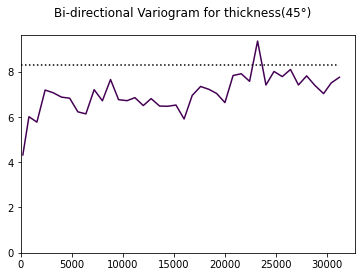

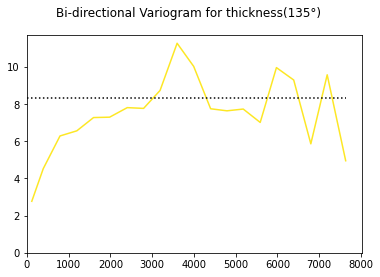

In [27]:
myVarioParamBidir = gl.VarioParam()
mydir = gl.DirParam(40,800.,0.5,45.,0,0,np.nan,np.nan,0.,[],[1,1])
myVarioParamBidir.addDir(mydir)
mydir = gl.DirParam(20,400.,0.5,45.,0,0,np.nan,np.nan,0.,[],[-1,1])
myVarioParamBidir.addDir(mydir)
myVarioBidir = gl.Vario(myVarioParamBidir,data)
err = myVarioBidir.compute(gl.ECalcVario.VARIOGRAM)
myVarioBidir.display()
axs = gp.varmod(myVarioBidir,idir=0,title="Bi-directional Variogram for thickness(45°)")
axs = gp.varmod(myVarioBidir,idir=1,title="Bi-directional Variogram for thickness(135°)")


Model characteristics
Space dimension              = 2
Number of variable(s)        = 1
Number of basic structure(s) = 2
Number of drift function(s)  = 0
Number of drift equation(s)  = 0

Covariance Part
---------------
Nugget Effect
- Sill         =      2.208
K-Bessel (Third Parameter = 1)
- Sill         =      4.699
- Ranges       =   1022.106  1497.510
- Theo. Ranges =    295.057   432.294
- Angles       =     45.000     0.000
- Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.707    -0.707
     [  1,]     0.707     0.707
Total Sill     =      6.907
 

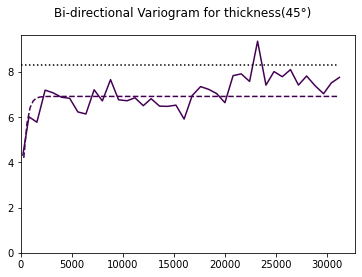

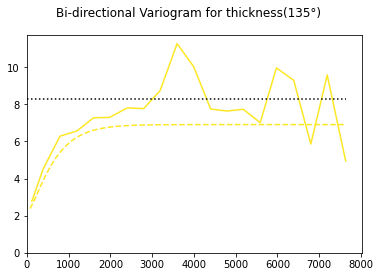

In [28]:
model = gl.Model.createFromDb(data)


structs = [gl.ECov.NUGGET,gl.ECov.BESSEL_K]

#consNug = gl.ConsItem.define(gl.EConsElem.SILL,0, type = gl.EConsType.UPPER,value = 0.1)

cons1P = gl.ConsItem.define(gl.EConsElem.PARAM,1, type = gl.EConsType.EQUAL,value = 1)
#cons1Rm = gl.ConsItem.define(gl.EConsElem.RANGE,1, type = gl.EConsType.LOWER,value = 100)
#cons1RM = gl.ConsItem.define(gl.EConsElem.RANGE,1, type = gl.EConsType.UPPER,value = 350)

#cons2P = gl.ConsItem.define(gl.EConsElem.PARAM,2, type = gl.EConsType.EQUAL,value = 2)
#cons2Rm = gl.ConsItem.define(gl.EConsElem.RANGE,2, type = gl.EConsType.LOWER,value = 100)
#cons2RM = gl.ConsItem.define(gl.EConsElem.RANGE,2, type = gl.EConsType.UPPER,value = 400)

a = gl.Constraints()
#a.addItem(consNug)
a.addItem(cons1P)
#a.addItem(cons1Rm)
#a.addItem(cons1RM)
#a.addItem(cons2P)
#a.addItem(cons2Rm)
#a.addItem(cons2RM)

err = model.fit(myVarioBidir,structs,constraints=a)


#err = model.fit(myVarioBidir,[gl.ECov.NUGGET,gl.ECov.BESSEL_K,gl.ECov.BESSEL_K], False)

model.display()
axs = gp.varmod(myVarioBidir,model,idir=0,title="Bi-directional Variogram for thickness(45°)")
axs = gp.varmod(myVarioBidir,model,idir=1,title="Bi-directional Variogram for thickness(135°)")

In [29]:
if not oldMethod :
    model = gl.Model.createFromDb(data)
    covBessel = gl.CovAniso.createAnisotropic(type = gl.ECov.BESSEL_K,ranges=ranges,sill=4.7,param=1,ctxt=model.getContext())
    covNugget = gl.CovAniso.createIsotropic(type = gl.ECov.NUGGET,sill=2.2,ctxt=model.getContext(),range=1)
    model.addCov(covNugget)
    model.addCov(covBessel)


In [30]:
grid.setLocator("Poly*", gl.ELoc.SEL)
#grid.setLocator("Poly*",gl.ELoc.UNKNOWN)

In [31]:
model.setDriftIRF(order = 0)

In [32]:
grid


Data Base Grid Characteristics

Data Base Summary
-----------------
File is organized as a regular grid
Space dimension              = 2
Number of Columns            = 7
Maximum Number of UIDs       = 7
Total number of samples      = 1320000
Number of active samples     = 138248

Grid characteristics:
---------------------
Origin : 630000.0006865000.000
Mesh   :     50.000    50.000
Number :       3300       400
Rotation Angles        =     40.000     0.000
Direct Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766     0.643
     [  1,]    -0.643     0.766
Inverse Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766    -0.643
     [  1,]     0.643     0.766

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = x1 - Locator = x1
Column = 2 - Name = x2 - Locator = x2
Column = 3 - Name = Polygon - Locator = sel
Column = 4 - Name = Migrate.u_interp - Locator = z1
Column = 5 - Name = Migrate.v_interp - Locator = z2
Column = 6 - 

In [33]:
u = grid["Migrate.u_interp"]
v = grid["Migrate.v_interp"]
res = 0. * u
for i in range(u.shape[0]):
    res[i] = gl.ut_vector_angle_from_codir((u[i][0], v[i][0]))[0]
    

In [34]:
grid.deleteColumn("angles*")
grid["angles1"]= res
grid.setLocator("angles*",gl.ELoc.NOSTAT)
nostat = gl.NoStatArray(["M2A"],grid)
if not oldMethod:
    model.addNoStat(nostat)

In [35]:
grid.deleteColumns(["spde*"])


In [36]:
spde = gl.SPDE(model,grid,data,gl.ESPDECalcMode.KRIGING)


For Non-Stationary Parameter (1), there are some undefined values (90455)
 They have been replaced by its average value (44.945091)
 

In [37]:
spde.compute()

In [38]:
iuid = spde.query(grid)

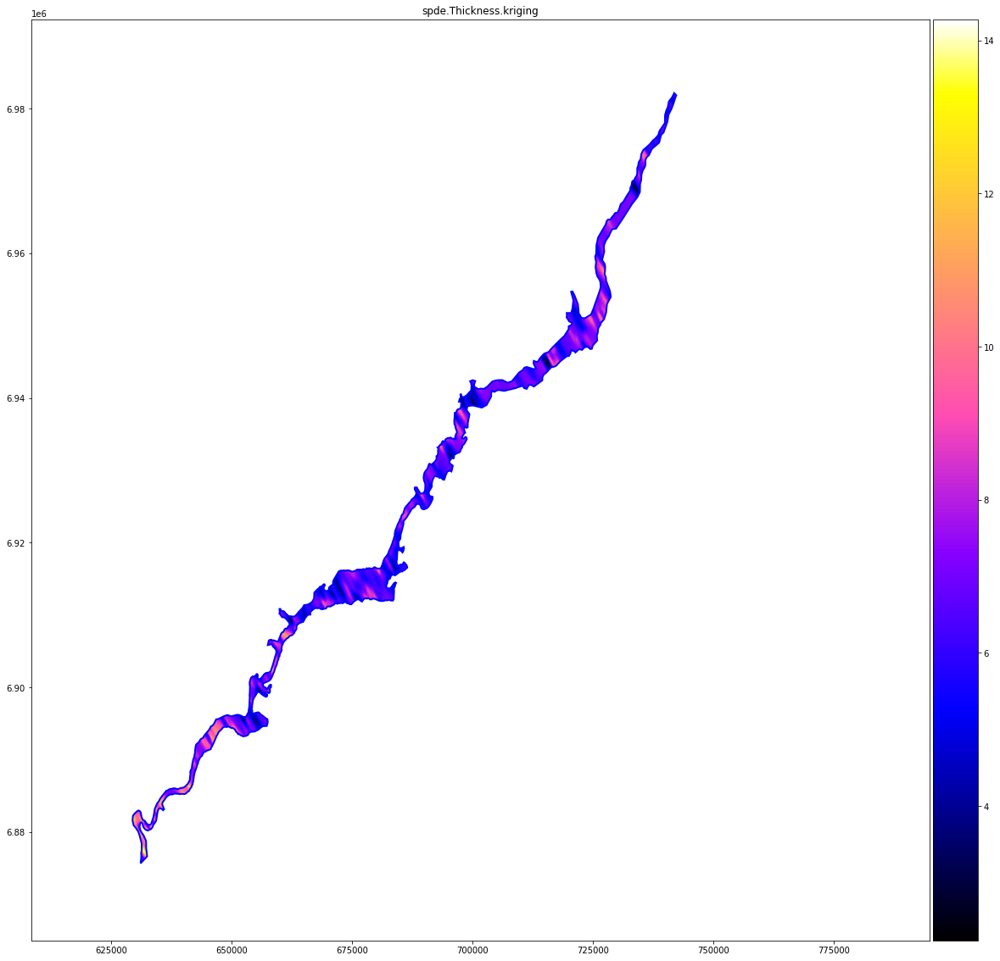

In [39]:
ax = gp.grid(grid,name="spde*kriging",cmap="gnuplot2", flagColorBar= True, figsize=[20,20])
#cbar=plt.colorbar(orientation="horizontal")
#cbar.set_label(label="Alluvial thickness (m)", size=20)
ax = gp.polygon(poly,ax=ax)
# ax = gp.point(data,ax=ax,size=1,color="white")

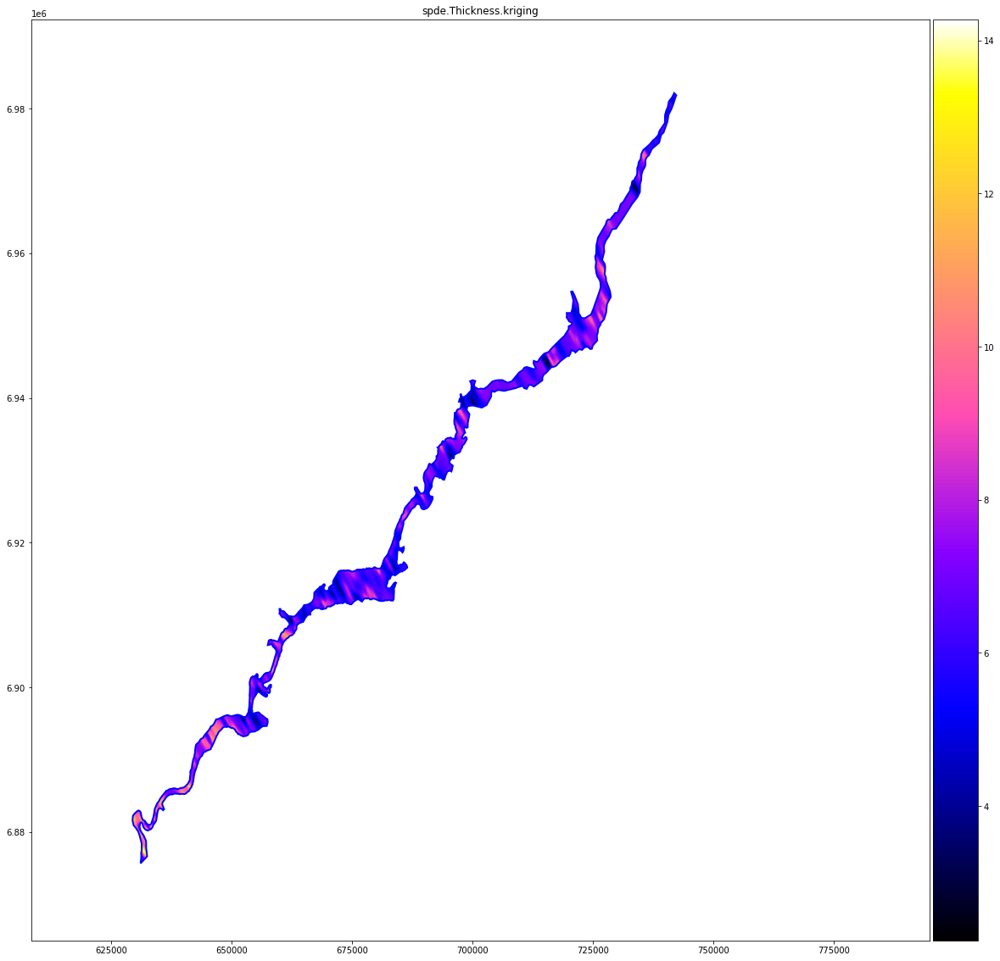

In [40]:
ax = gp.grid(grid,name="spde*kriging",cmap="gnuplot2", flagColorBar= True, figsize=[20,20])
#cbar=plt.colorbar(orientation="horizontal")
#cbar.set_label(label="Alluvial thickness (m)", size=20)
ax = gp.polygon(poly,ax=ax)
# ax = gp.point(data,ax=ax,size=1,color="white")


Data Base Grid Characteristics

Data Base Summary
-----------------
File is organized as a regular grid
Space dimension              = 2
Number of Columns            = 9
Maximum Number of UIDs       = 9
Total number of samples      = 1320000
Number of active samples     = 138248

Grid characteristics:
---------------------
Origin : 630000.0006865000.000
Mesh   :     50.000    50.000
Number :       3300       400
Rotation Angles        =     40.000     0.000
Direct Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766     0.643
     [  1,]    -0.643     0.766
Inverse Rotation Matrix
               [,  0]    [,  1]
     [  0,]     0.766    -0.643
     [  1,]     0.643     0.766

Variables
---------
Column = 0 - Name = rank - Locator = NA
Column = 1 - Name = x1 - Locator = x1
Column = 2 - Name = x2 - Locator = x2
Column = 3 - Name = Polygon - Locator = sel
Column = 4 - Name = Migrate.u_interp - Locator = NA
Column = 5 - Name = Migrate.v_interp - Locator = NA
Column = 6 - 

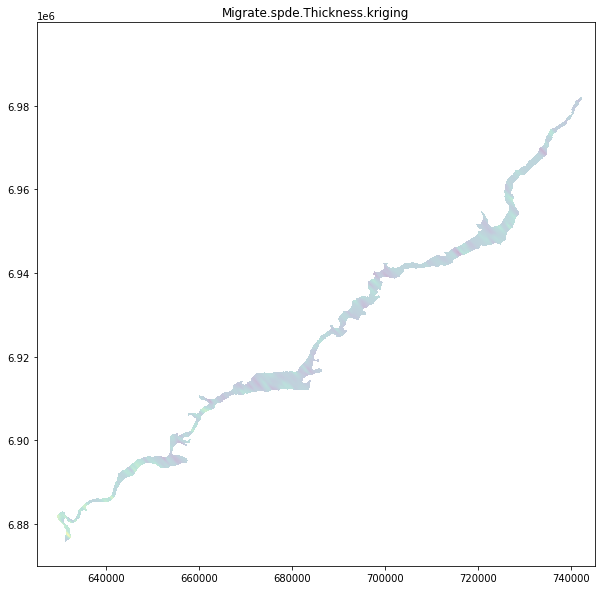

In [41]:
#Kriging data to new grid
raster = gl.DbGrid()
raster.reset([2400,2600],[50,50],[625000,6870000],[0,0])
gl.migrate(grid, raster, "spde.Thickness.kriging",2,[100,100],True)

# Visualize
ax = gp.grid(raster,flagColorBar=False,alpha=0.3,figsize=[10,10],usesel=False)
raster
grid

In [42]:
# Write the contents of the file into an external file using ArcGis format

#aof = gl.GridArcGis("KrigSPDE.txt",raster)
#aof.setCol(3)
#if aof.isAuthorized():
#    aof.writeInFile()

In [43]:
# Export Kriging grid to Ascii for Raster format => raster.gridwrite.format("arcgis","filename.txt")
Kri=raster.getColumn("Migrate.spde.Thickness.kriging")
len(Kri)
KriG = np.array(Kri)
KriG = np.where(KriG > 1000, -999999, KriG)
KriG = np.where(KriG==0, -999999, KriG) 
np.savetxt("filename.txt", KriG)